### Data Analysis for Business Layer

We derive business insights from analysis on Gold Layer processed data layer
- We join the shooting data with nypd precincts data to map precincts to neighborhoods
- We convert the processed data to a pandas dataframe for EDA
- We perform Race, Gender and Age based analysis on Victims and Perpetrators
- We analyse the number of deaths across each Race and Age Group
- We perform temporal analysis to find out Yearly, Monthly and Daily patterns of shooting incidents
- We Map the shooting incidents on Geographical Map for better visualisation
- We analyze shooting incidents on Neighbourhood level

## Importing Libraries

In [57]:
import sys
sys.path.append("..")

In [58]:
from snowflake.snowpark import Session
from snowflake.snowpark.functions import when, col, count
from datetime import date
from helpers import SnowflakeHelper
import os
import json
import pandas as pd
import numpy as np
import functools as ft
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium.plugins import MarkerCluster

## Extracting Data from Snowflake

In [59]:
schema_name = "SAFEGUARDING_NYC_SCHEMA_GOLD"
snowflake_helper = SnowflakeHelper(schema_name)
snowflake_config = './../helpers/snowflake_config.json'
session = snowflake_helper.create_snowpark_session(snowflake_config)

[INFO] Using the schema SAFEGUARDING_NYC_SCHEMA_GOLD for the session
[SUCCESS] Config file loaded successfully!
[SUCCESS] Snowspark Session created successfully on schema SAFEGUARDING_NYC_SCHEMA_GOLD!


In [60]:
shooting_incidents = session.table('shooting_incidents')
shooting_incidents.show()

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|"OCCUR_DATE"  |"OCCUR_TIME"  |"INCIDENT_KEY"  |"LATITUDE"   |"STATISTICAL_MURDER_FLAG"  |"LONGITUDE"   |"BORO"     |"LOCATION_DESC"            |"PRECINCT"  |"PERP_AGE_GROUP"  |"VIC_AGE_GROUP"  |"VIC_RACE"      |"PERP_RACE"     |"PERP_SEX"  |"VIC_SEX"  |
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|2007-05-04    |19:13:00      |28832628        |40.70370632  |FALSE                      |-73.94325706  |BROOKLYN   |MULTI DWELL - PUBLIC HOUS  |90          |<18               |<18              |BLACK           |BLACK           |MALE  

In [61]:
NYPD_PRECINCTS_NEIGHBORHOODS = session.table("NYPD_PRECINCTS_NEIGHBORHOODS")
NYPD_PRECINCTS_NEIGHBORHOODS.show()

-------------------------------------------------------------------
|"NEIGHBORHOODS"                                     |"PRECINCT"  |
-------------------------------------------------------------------
|World Trade Center/SOHO/Tribeca/Wall Street.        |1           |
|Chinatown/Little Italy                              |5           |
|Greenwich Village/West Village                      |6           |
|Williamsburg Bridge/Orchard Street                  |7           |
|East Village                                        |9           |
|Chelsea, Clinton/Hell's Kitchen South/Hudson Yards  |10          |
|Peter Cooper Village/Stuyvesant Town residentia...  |13          |
|Sutton Area/Beekman Place/Kipps Bay/Turtle Bay/...  |17          |
|Madison/Lexington/3rd Avenues                       |19          |
|Lincoln Center for the Performing Arts/the Amer...  |20          |
-------------------------------------------------------------------



In [67]:
shooting_incidents_combined_with_neighborhoods = shooting_incidents.join(
    NYPD_PRECINCTS_NEIGHBORHOODS, 
    shooting_incidents['PRECINCT'] == NYPD_PRECINCTS_NEIGHBORHOODS['PRECINCT'], 
    how="left"
)
shooting_incidents_combined_with_neighborhoods.show()

----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|"OCCUR_DATE"  |"OCCUR_TIME"  |"INCIDENT_KEY"  |"LATITUDE"   |"STATISTICAL_MURDER_FLAG"  |"LONGITUDE"   |"BORO"     |"LOCATION_DESC"            |"l_io1j_PRECINCT"  |"PERP_AGE_GROUP"  |"VIC_AGE_GROUP"  |"VIC_RACE"      |"PERP_RACE"     |"PERP_SEX"  |"VIC_SEX"  |"NEIGHBORHOODS"                                     |"r_j68p_PRECINCT"  |
------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

## Converting to Pandas Dataframe for EDA

In [71]:
# Assuming 'snowpark_df' is your Snowpark DataFrame
data = shooting_incidents_combined_with_neighborhoods.collect()

shooting_data = pd.DataFrame(data, columns=[col.name for col in shooting_incidents_combined_with_neighborhoods.schema.fields])
shooting_data

,OCCUR_DATE,OCCUR_TIME,INCIDENT_KEY,LATITUDE,STATISTICAL_MURDER_FLAG,LONGITUDE,BORO,LOCATION_DESC,"""l_io1j_PRECINCT""",PERP_AGE_GROUP,VIC_AGE_GROUP,VIC_RACE,PERP_RACE,PERP_SEX,VIC_SEX,NEIGHBORHOODS
0,2021-05-27,21:30:00,228798151,40.66296462,FALSE,-73.73083869,QUEENS,None,105,None,18-24,BLACK,None,None,MALE,Queens Village/Cambria Heights/Laurelton/Rosed...
1,2014-06-27,17:40:00,137471050,40.81035186,FALSE,-73.92494233,BRONX,None,40,None,18-24,BLACK,None,None,MALE,Port Morris/Mott Haven/Melrose
2,2015-11-21,3:56:00,147998800,40.74260663,TRUE,-73.91549174,QUEENS,None,108,None,25-44,WHITE,None,None,MALE,Long Island City/Sunnyside/Woodside
3,2015-10-09,18:30:00,146837977,40.837782,FALSE,-73.91945661,BRONX,None,44,None,<18,WHITE HISPANIC,None,None,MALE,Grand Concourse/Bronx Terminal Market/Yankee S...
4,2009-02-19,22:58:00,58921844,40.88623792,TRUE,-73.85290951,BRONX,None,47,25-44,45-64,BLACK,BLACK,MALE,MALE,Woodlawn/Wakefield/Williamsbridge/Baychester/E...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27307,2022-05-14,3:02:00,245029823,40.84686352,FALSE,-73.90141321,BRONX,None,48,None,18-24,BLACK,None,None,MALE,Belmont/East Tremont/West Farms
27308,2022-01-22,13:15:00,239583450,40.826743,FALSE,-73.952273,MANHATTAN,None,30,25-44,25-44,WHITE HISPANIC,WHITE HISPANIC,FEMALE,MALE,Hamilton Heights/Sugar Hill/West Harlem
27309,2022-06-18,3:29:00,246825728,40.81020941,FALSE,-73.9394955,MANHATTAN,None,32,18-24,25-44,BLACK,BLACK,MALE,MALE,Northeast Harlem
27310,2022-06-19,20:08:00,246876579,40.855644,FALSE,-73.896141,BRONX,MULTI DWELL - PUBLIC HOUS,46,25-44,25-44,WHITE HISPANIC,BLACK,MALE,MALE,Fordham/University Heights/Morris Heights/Moun...


In [82]:
shooting_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27312 entries, 0 to 27311
Data columns (total 20 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   OCCUR_DATE               27312 non-null  datetime64[ns]
 1   OCCUR_TIME               27312 non-null  datetime64[ns]
 2   INCIDENT_KEY             27312 non-null  object        
 3   LATITUDE                 27302 non-null  object        
 4   STATISTICAL_MURDER_FLAG  27312 non-null  object        
 5   LONGITUDE                27302 non-null  object        
 6   BORO                     27312 non-null  object        
 7   LOCATION_DESC            11183 non-null  object        
 8   PRECINCT                 27312 non-null  object        
 9   PERP_AGE_GROUP           27312 non-null  object        
 10  VIC_AGE_GROUP            27312 non-null  object        
 11  VIC_RACE                 27312 non-null  object        
 12  PERP_RACE                27312 n

In [83]:
shooting_data.describe()

,OCCUR_DATE,OCCUR_TIME,Year,Month,Hour_of_Day
count,27312,27312,27312.000000,27312.000000,27312.000000
mean,2014-01-06 23:14:14.130052608,1900-01-01 12:41:31.709138944,2013.492494,6.825168,12.222832
min,2006-01-01 00:00:00,1900-01-01 00:00:00,2006.000000,1.000000,0.000000
25%,2009-07-18 00:00:00,1900-01-01 03:27:00,2009.000000,5.000000,3.000000
50%,2013-04-29 00:00:00,1900-01-01 15:11:00,2013.000000,7.000000,15.000000
75%,2018-10-15 00:00:00,1900-01-01 20:45:00,2018.000000,9.000000,20.000000
max,2022-12-31 00:00:00,1900-01-01 23:59:00,2022.000000,12.000000,23.000000
std,NaN,NaN,5.143086,3.128859,8.486079


## Race, Age and Gender Analysis

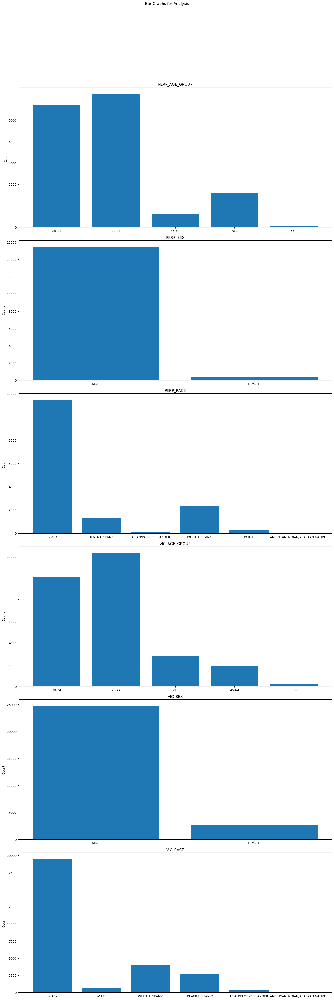

In [84]:

# Handle None values in the specified columns
shooting_data['PERP_AGE_GROUP'] = shooting_data['PERP_AGE_GROUP'].astype(str)
shooting_data['PERP_SEX'] = shooting_data['PERP_SEX'].astype(str)
shooting_data['PERP_RACE'] = shooting_data['PERP_RACE'].astype(str)
shooting_data['VIC_AGE_GROUP'] = shooting_data['VIC_AGE_GROUP'].astype(str)
shooting_data['VIC_SEX'] = shooting_data['VIC_SEX'].astype(str)
shooting_data['VIC_RACE'] = shooting_data['VIC_RACE'].astype(str)

# Distinct values for specified columns
perp_age_group_values = shooting_data['PERP_AGE_GROUP'].unique()
perp_sex_values = shooting_data['PERP_SEX'].unique()
perp_race_values = shooting_data['PERP_RACE'].unique()
vic_age_group_values = shooting_data['VIC_AGE_GROUP'].unique()
vic_sex_values = shooting_data['VIC_SEX'].unique()
vic_race_values = shooting_data['VIC_RACE'].unique()

# Removing None Values
perp_age_group_values = perp_age_group_values[perp_age_group_values != 'None']
perp_sex_values = perp_sex_values[perp_sex_values != 'None']
perp_race_values = perp_race_values[perp_race_values != 'None']
vic_age_group_values = vic_age_group_values[vic_age_group_values != 'None']
vic_sex_values = vic_sex_values[vic_sex_values != 'None']
vic_race_values = vic_race_values[vic_race_values != 'None']

# Plotting bar graphs
fig, axes = plt.subplots(6, 1, figsize=(15, 45))
fig.suptitle('Bar Graphs for Analysis', y=1.02)

# Plot for PERP_AGE_GROUP
axes[0].bar(perp_age_group_values, shooting_data['PERP_AGE_GROUP'].value_counts().loc[perp_age_group_values])
axes[0].set_title('PERP_AGE_GROUP')
axes[0].set_ylabel('Count')

# Plot for PERP_SEX
axes[1].bar(perp_sex_values, shooting_data['PERP_SEX'].value_counts().loc[perp_sex_values])
axes[1].set_title('PERP_SEX')
axes[1].set_ylabel('Count')

# Plot for PERP_RACE
axes[2].bar(perp_race_values, shooting_data['PERP_RACE'].value_counts().loc[perp_race_values])
axes[2].set_title('PERP_RACE')
axes[2].set_ylabel('Count')

# Plot for VIC_AGE_GROUP
axes[3].bar(vic_age_group_values, shooting_data['VIC_AGE_GROUP'].value_counts().loc[vic_age_group_values])
axes[3].set_title('VIC_AGE_GROUP')
axes[3].set_ylabel('Count')

# Plot for VIC_SEX
axes[4].bar(vic_sex_values, shooting_data['VIC_SEX'].value_counts().loc[vic_sex_values])
axes[4].set_title('VIC_SEX')
axes[4].set_ylabel('Count')

# Plot for VIC_RACE
axes[5].bar(vic_race_values, shooting_data['VIC_RACE'].value_counts().loc[vic_race_values])
axes[5].set_title('VIC_RACE')
axes[5].set_ylabel('Count')

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

# Show the plot
plt.show()


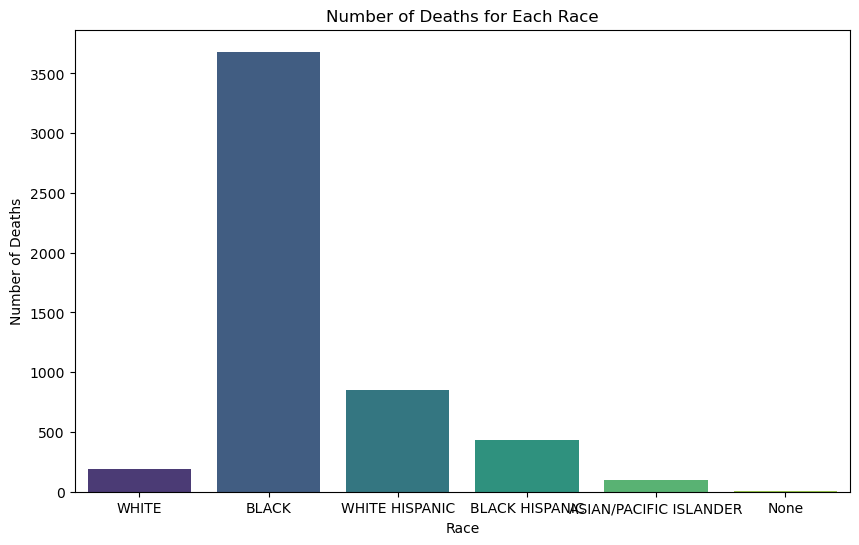

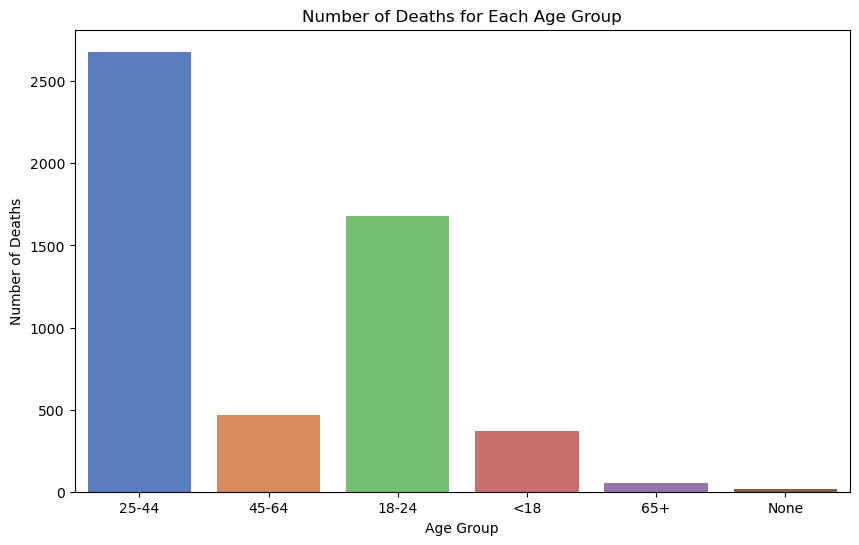

In [124]:
# Filter the DataFrame for rows where 'STATISTICAL_MURDER_FLAG' is True
flag_true_df = shooting_data[shooting_data['STATISTICAL_MURDER_FLAG'] == "TRUE"]

# Plot 1: Number of deaths for each race where 'STATISTICAL_MURDER_FLAG' is True
plt.figure(figsize=(10, 6))
sns.countplot(x='VIC_RACE', data=flag_true_df, palette='viridis')
plt.title('Number of Deaths for Each Race')
plt.xlabel('Race')
plt.ylabel('Number of Deaths')
plt.show()

# Plot 2: Number of deaths for each age group where 'STATISTICAL_MURDER_FLAG' is True
plt.figure(figsize=(10, 6))
sns.countplot(x='VIC_AGE_GROUP', data=flag_true_df, palette='muted')
plt.title('Number of Deaths for Each Age Group')
plt.xlabel('Age Group')
plt.ylabel('Number of Deaths')
plt.show()



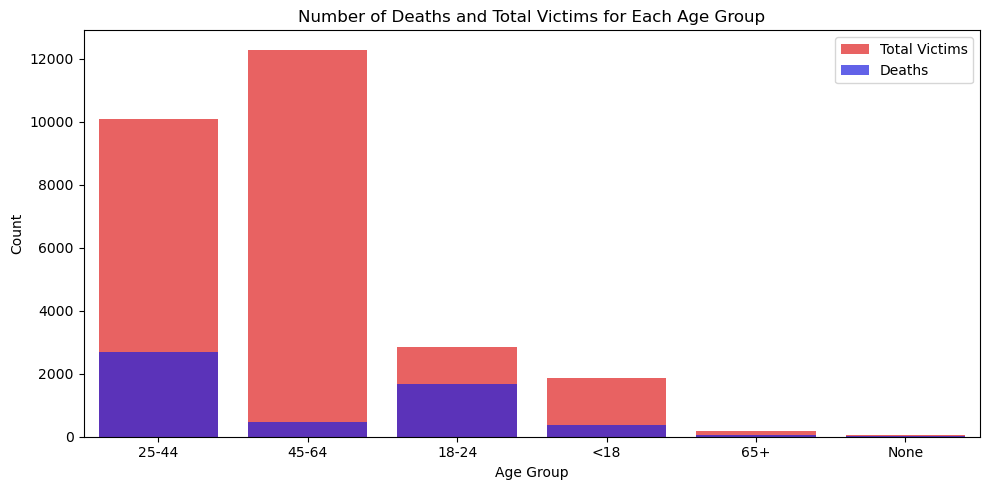

In [125]:
# Deaths and total victims by Age Group
plt.figure(figsize=(10, 5))
sns.countplot(x='VIC_AGE_GROUP', data=shooting_data, color='red', label='Total Victims', alpha=0.7)
sns.countplot(x='VIC_AGE_GROUP', data=flag_true_df, color='blue', label='Deaths', alpha=0.7)
plt.title('Number of Deaths and Total Victims for Each Age Group')
plt.xlabel('Age Group')
plt.ylabel('Count')
plt.legend()

plt.tight_layout()
plt.show()



## Temporal Analysis

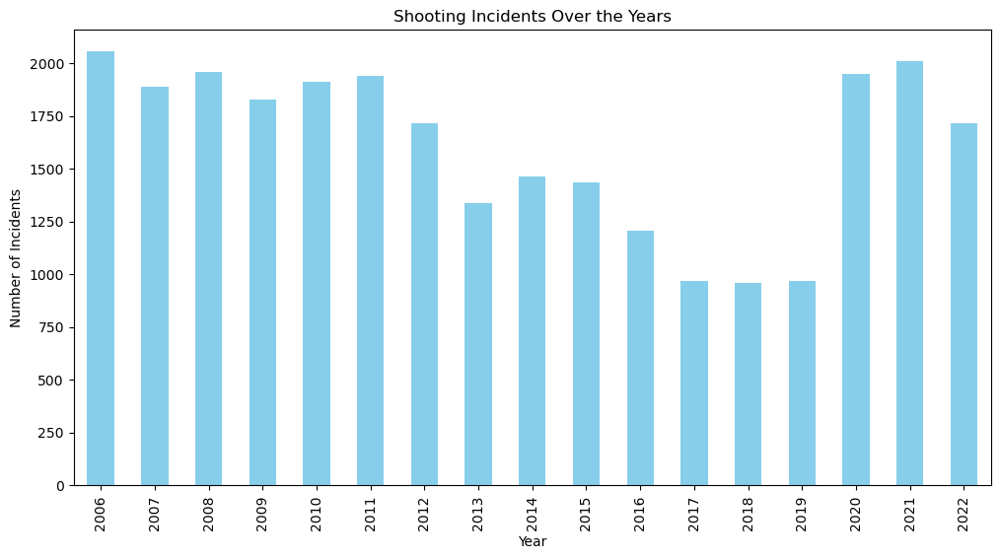

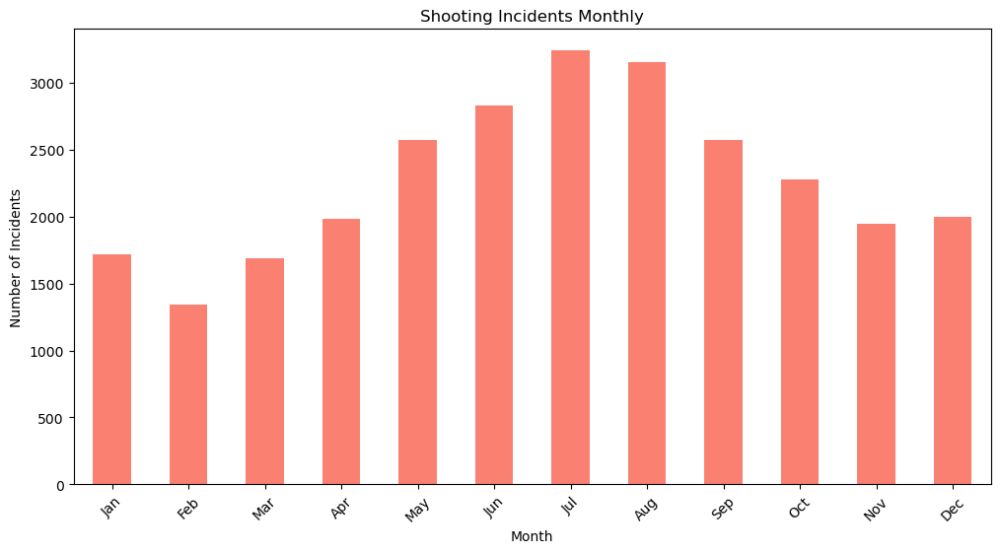

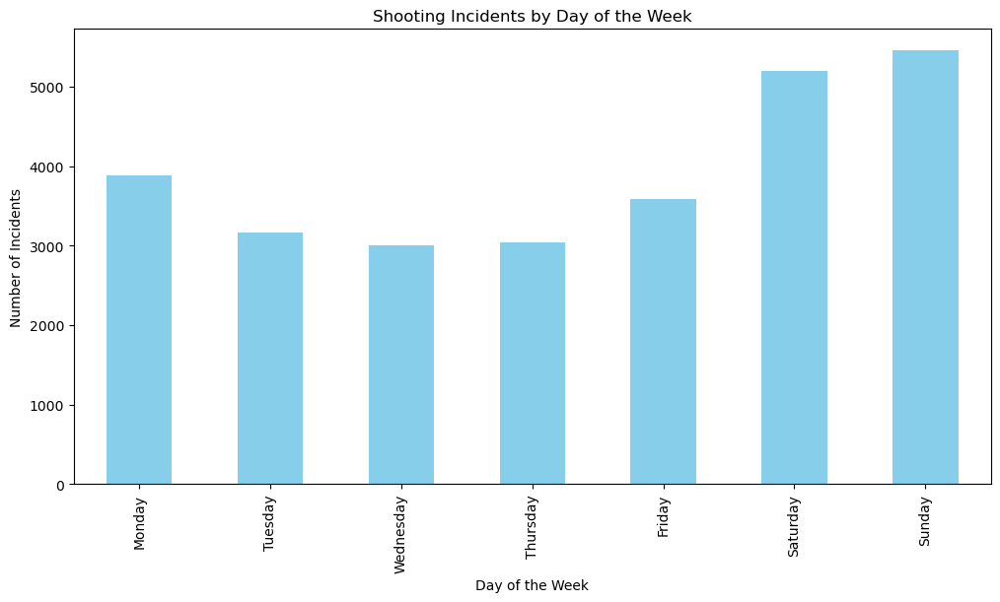

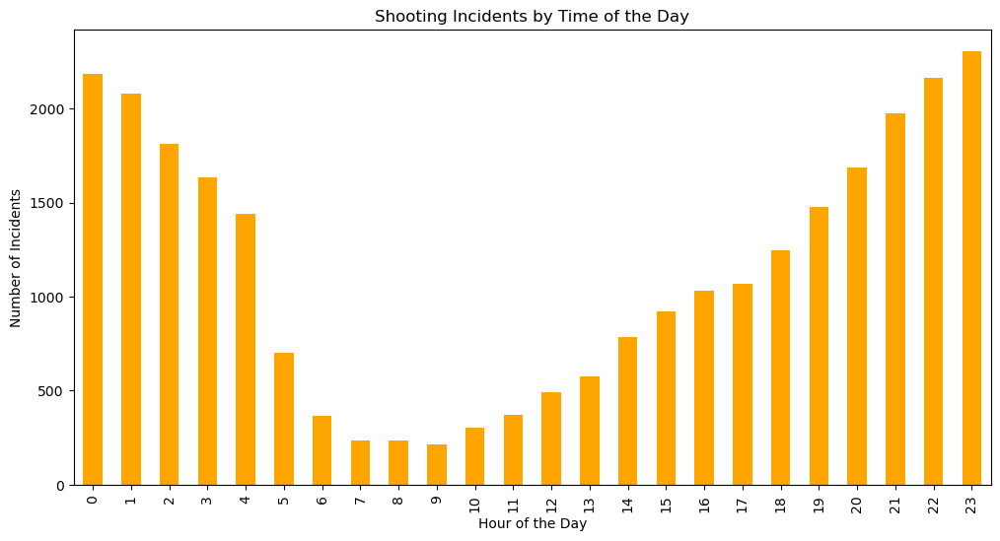

In [126]:
shooting_data['OCCUR_DATE'] = pd.to_datetime(shooting_data['OCCUR_DATE'])

# Plot 1
# Extract year from 'OCCUR_DATE'
shooting_data['Year'] = shooting_data['OCCUR_DATE'].dt.year

# Plotting the graph
plt.figure(figsize=(12, 6))
shooting_data['Year'].value_counts().sort_index().plot(kind='bar', color='skyblue')
plt.title('Shooting Incidents Over the Years')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.show()

# Plot 2
# Extract month from 'OCCUR_DATE'
shooting_data['Month'] = shooting_data['OCCUR_DATE'].dt.month

# Define month names for labeling
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

# Plotting the graph
plt.figure(figsize=(12, 6))
shooting_data['Month'].value_counts().sort_index().plot(kind='bar', color='salmon')
plt.title('Shooting Incidents Monthly')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.xticks(range(0, 12), month_names, rotation=45)
plt.show()

# Plot 3
# Extract day of the week from 'OCCUR_DATE'
shooting_data['Day_of_Week'] = shooting_data['OCCUR_DATE'].dt.day_name()

# Plotting the graph
plt.figure(figsize=(12, 6))
shooting_data['Day_of_Week'].value_counts().reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']).plot(kind='bar', color='skyblue')
plt.title('Shooting Incidents by Day of the Week')
plt.xlabel('Day of the Week')
plt.ylabel('Number of Incidents')
plt.show()

# Plot 4
# Convert 'OCCUR_TIME' to datetime
shooting_data['OCCUR_TIME'] = pd.to_datetime(shooting_data['OCCUR_TIME'], format='%H:%M:%S', errors='coerce')

# Extract hour of the day from 'OCCUR_TIME'
shooting_data['Hour_of_Day'] = shooting_data['OCCUR_TIME'].apply(lambda x: x.hour)

# Plotting the graph
plt.figure(figsize=(12, 6))
shooting_data['Hour_of_Day'].value_counts().sort_index().plot(kind='bar', color='orange')
plt.title('Shooting Incidents by Time of the Day')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Incidents')
plt.show()

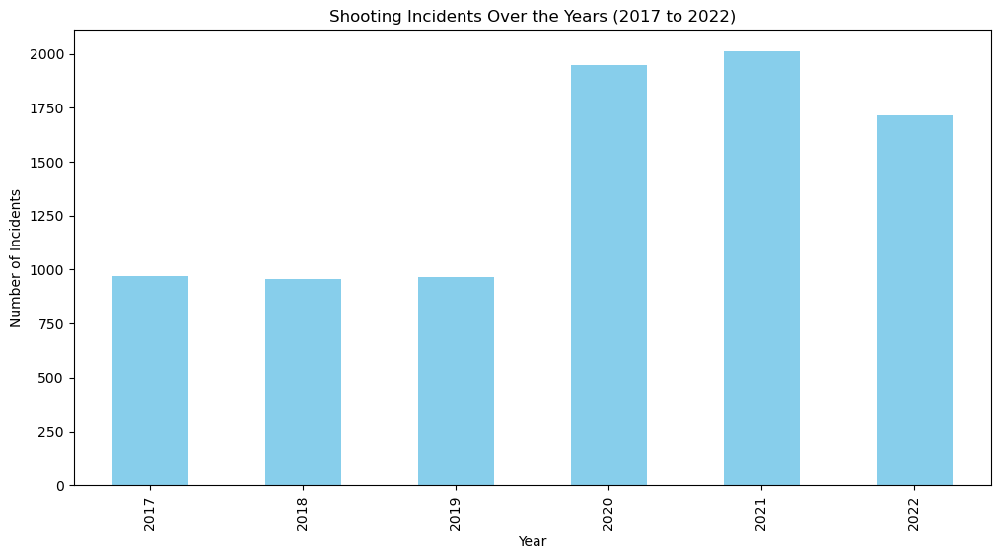

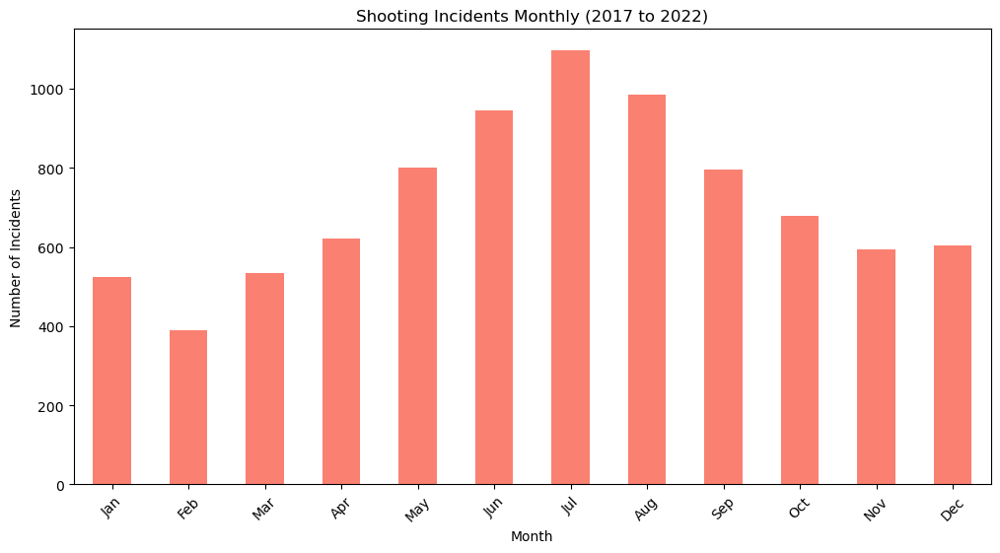

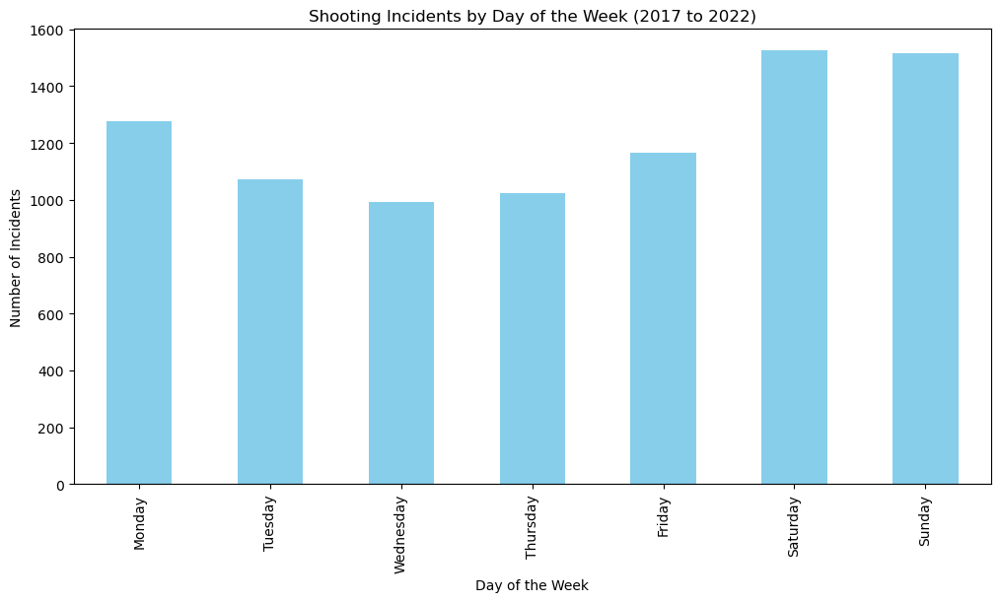

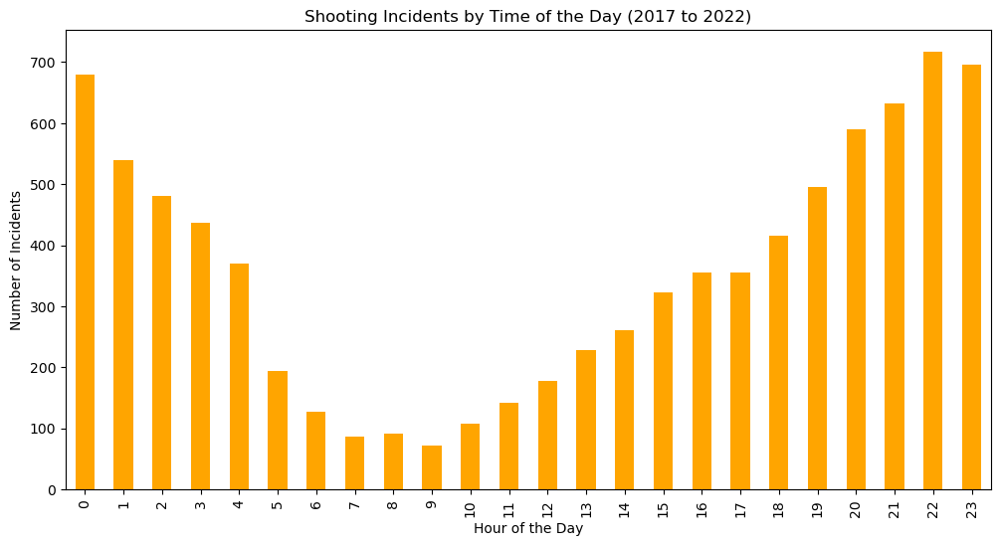

In [129]:
# Filter shooting_data for the years 2017 to 2022
filtered_data = shooting_data[(shooting_data['Year'] >= 2017) & (shooting_data['Year'] <= 2022)]

# Plot 1
plt.figure(figsize=(12, 6))
filtered_data['Year'].value_counts().sort_index().plot(kind='bar', color='skyblue')
plt.title('Shooting Incidents Over the Years (2017 to 2022)')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.show()

# Plot 2
plt.figure(figsize=(12, 6))
filtered_data['Month'].value_counts().sort_index().plot(kind='bar', color='salmon')
plt.title('Shooting Incidents Monthly (2017 to 2022)')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.xticks(range(0, 12), month_names, rotation=45)
plt.show()

# Plot 3
plt.figure(figsize=(12, 6))
filtered_data['Day_of_Week'].value_counts().reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']).plot(kind='bar', color='skyblue')
plt.title('Shooting Incidents by Day of the Week (2017 to 2022)')
plt.xlabel('Day of the Week')
plt.ylabel('Number of Incidents')
plt.show()

# Plot 4
plt.figure(figsize=(12, 6))
filtered_data['Hour_of_Day'].value_counts().sort_index().plot(kind='bar', color='orange')
plt.title('Shooting Incidents by Time of the Day (2017 to 2022)')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Incidents')
plt.show()


/var/folders/wt/_pw2b7191fd_mks62z_kdz200000gn/T/ipykernel_40641/3292833557.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shooting_data_1719['Month'] = shooting_data_1719['OCCUR_DATE'].dt.month


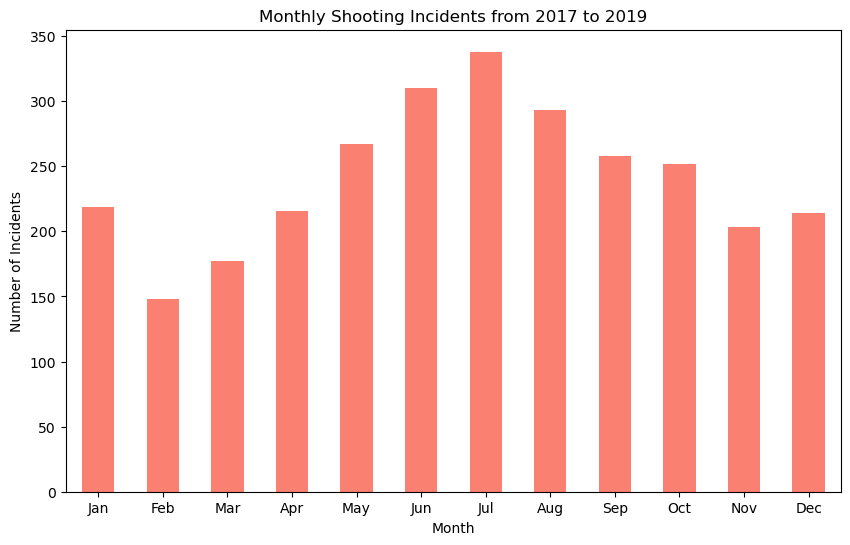

/var/folders/wt/_pw2b7191fd_mks62z_kdz200000gn/T/ipykernel_40641/3292833557.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  shooting_data_20to22['Month'] = shooting_data_20to22['OCCUR_DATE'].dt.month


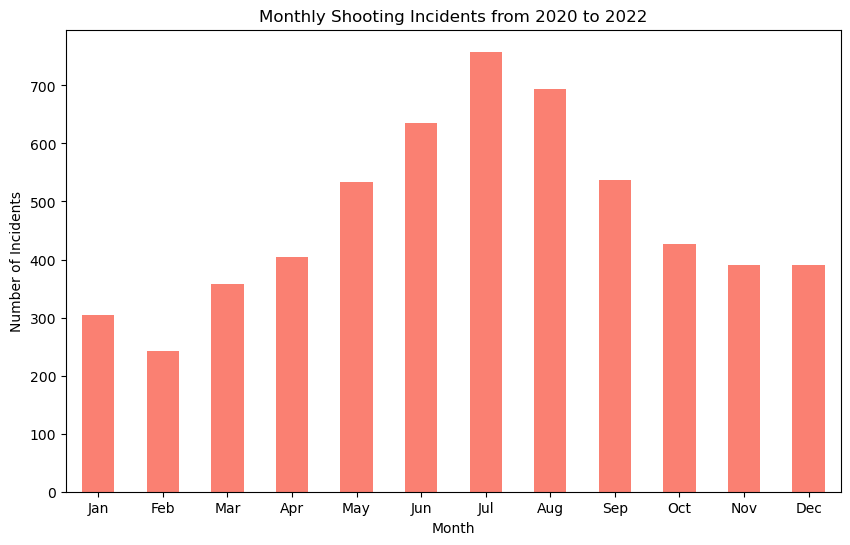

In [87]:
# Plot 1
# Filter data for the year 2020
shooting_data_1719 = shooting_data[(shooting_data['OCCUR_DATE'] >= '2017-01-01') & (shooting_data['OCCUR_DATE'] < '2020-01-01')]

# Extract month from 'OCCUR_DATE'
shooting_data_1719['Month'] = shooting_data_1719['OCCUR_DATE'].dt.month

# Plotting the graph
monthly_counts_1719 = shooting_data_1719['Month'].value_counts().sort_index()
monthly_counts_1719.plot(kind='bar', figsize=(10, 6), color='salmon')
plt.title('Monthly Shooting Incidents from 2017 to 2019')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.xticks(range(0, 12), month_names, rotation=0)
plt.show()

# Plot 2
# Filter data for the year 2020
shooting_data_20to22 = shooting_data[(shooting_data['OCCUR_DATE'] >= '2020-01-01')]

# Extract month from 'OCCUR_DATE'
shooting_data_20to22['Month'] = shooting_data_20to22['OCCUR_DATE'].dt.month

# Plotting the graph
monthly_counts_20to22 = shooting_data_20to22['Month'].value_counts().sort_index()
monthly_counts_20to22.plot(kind='bar', figsize=(10, 6), color='salmon')
plt.title('Monthly Shooting Incidents from 2020 to 2022')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.xticks(range(0, 12), month_names, rotation=0)
plt.show()

## Race Target Analysis

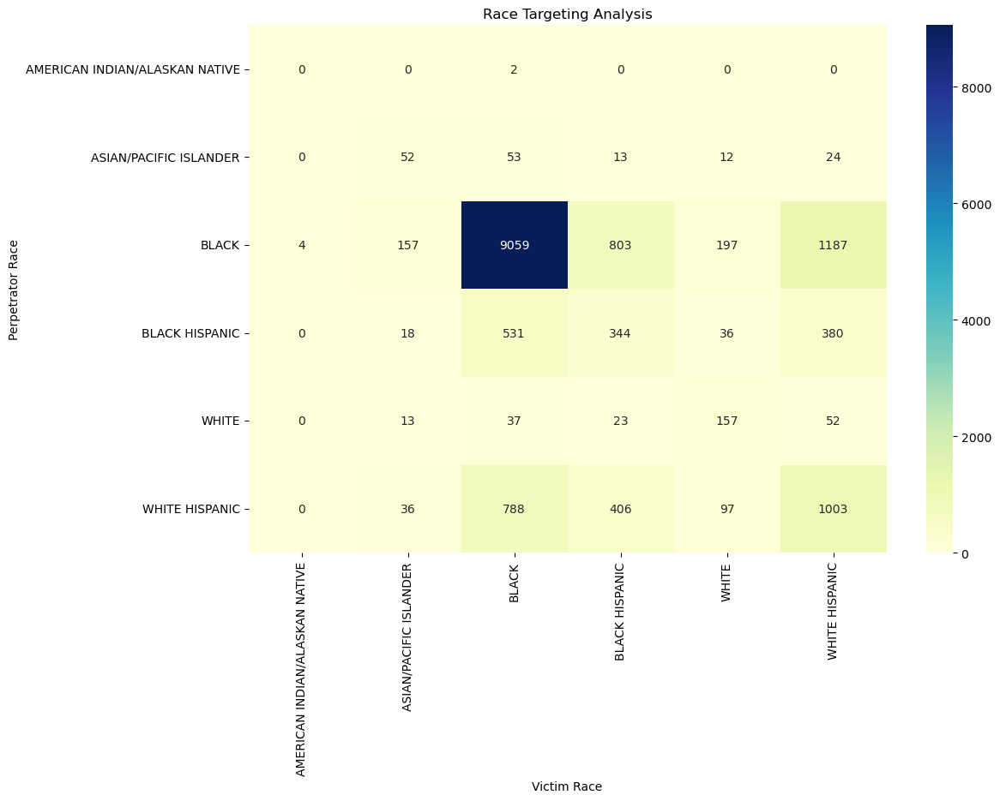

In [88]:
# Filter the DataFrame to exclude None values in both perpetrator and victim races
filtered_df = shooting_data.dropna(subset=['PERP_RACE', 'VIC_RACE'])

filtered_df = filtered_df[(filtered_df['PERP_RACE'] != 'None') & (filtered_df['VIC_RACE'] != 'None')]

# Create a cross-tabulation of perpetrator race vs. victim race
race_targeting = pd.crosstab(filtered_df['PERP_RACE'], filtered_df['VIC_RACE'])

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(race_targeting, annot=True, cmap='YlGnBu', fmt='d', cbar=True)
plt.title('Race Targeting Analysis')
plt.xlabel('Victim Race')
plt.ylabel('Perpetrator Race')
plt.show()

## Mapping using Lon and Lat

In [89]:
# Filter the DataFrame to include only rows with valid latitude and longitude
map_data = shooting_data.dropna(subset=['LATITUDE', 'LONGITUDE'])

# Create a base map centered around NYC
nyc_map = folium.Map(location=[40.7128, -74.0060], zoom_start=10)

# Create a MarkerCluster for shooting incidents
shooting_cluster = MarkerCluster().add_to(nyc_map)

# Add markers for each shooting incident
for index, row in map_data.iterrows():
    folium.Marker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        popup=f"Occur Date: {row['OCCUR_DATE']}<br>Occur Time: {row['OCCUR_TIME']}<br>Boro: {row['BORO']}<br>Precinct: {row['PRECINCT']}",
        icon=None,  # You can customize the icon if needed
    ).add_to(shooting_cluster)

# Display the map
nyc_map

## Neighborhood Level Analysis

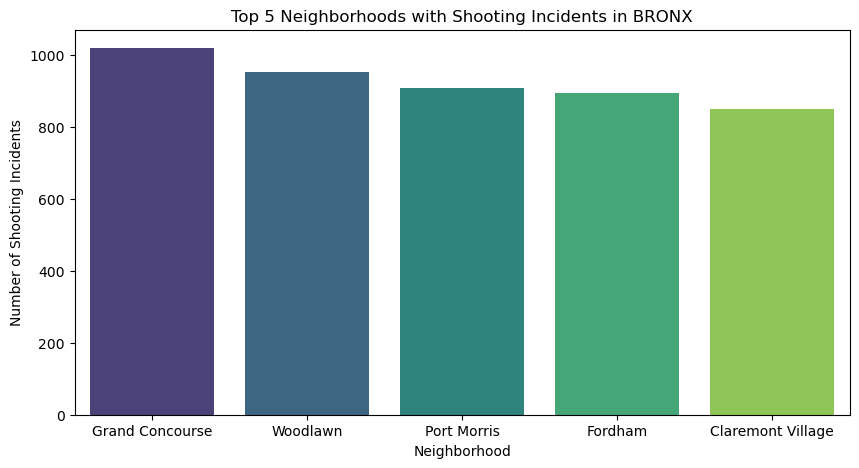

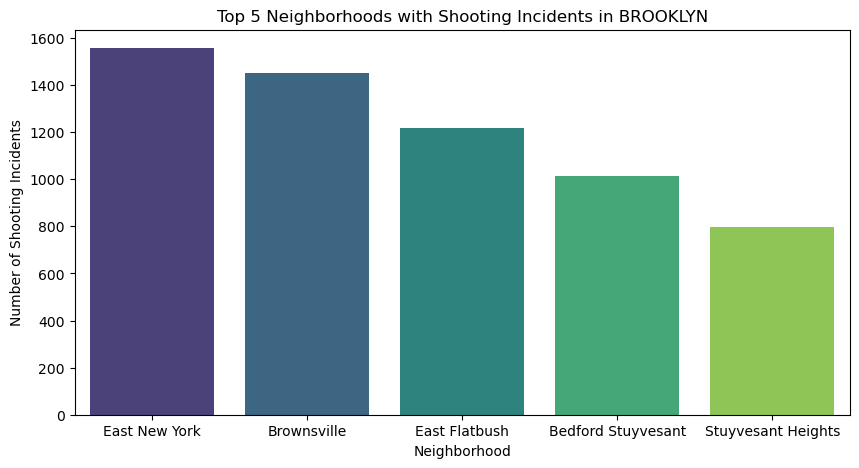

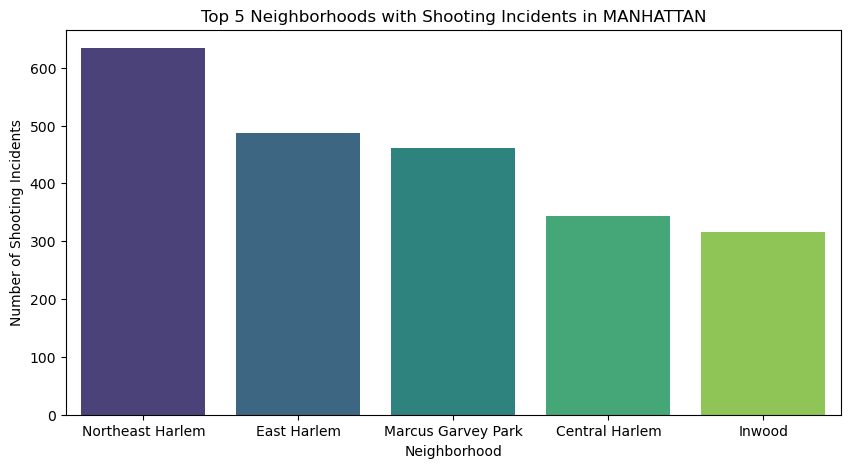

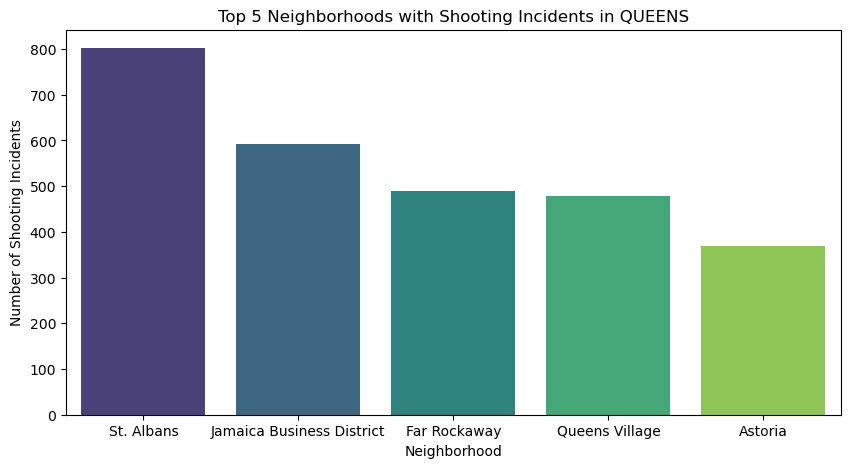

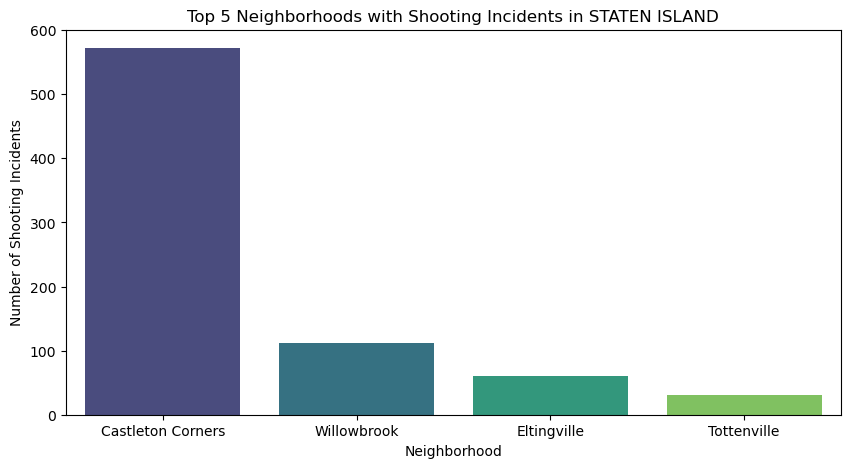

In [102]:
# Calculate the number of shooting incidents for each neighborhood in each borough
neighborhood_counts = shooting_data.groupby(['BORO', 'NEIGHBORHOODS']).size().reset_index(name='Incident Count')

# Sort the data by incident count within each borough
neighborhood_counts_sorted = neighborhood_counts.sort_values(by=['BORO', 'Incident Count'], ascending=[True, False])

# Plot the top 5 neighborhoods for each borough
for borough in neighborhood_counts_sorted['BORO'].unique():
    top5_neighborhoods = neighborhood_counts_sorted[neighborhood_counts_sorted['BORO'] == borough].head(5)
    
    # Extract the first part of the neighborhood before the '/'
    top5_neighborhoods['Short Neighborhood'] = top5_neighborhoods['NEIGHBORHOODS'].apply(lambda x: x.split('/')[0].strip())
    
    plt.figure(figsize=(10, 5))
    sns.barplot(x='Short Neighborhood', y='Incident Count', data=top5_neighborhoods, palette='viridis')
    plt.title(f'Top 5 Neighborhoods with Shooting Incidents in {borough}')
    plt.xlabel('Neighborhood')
    plt.ylabel('Number of Shooting Incidents')
    plt.show()

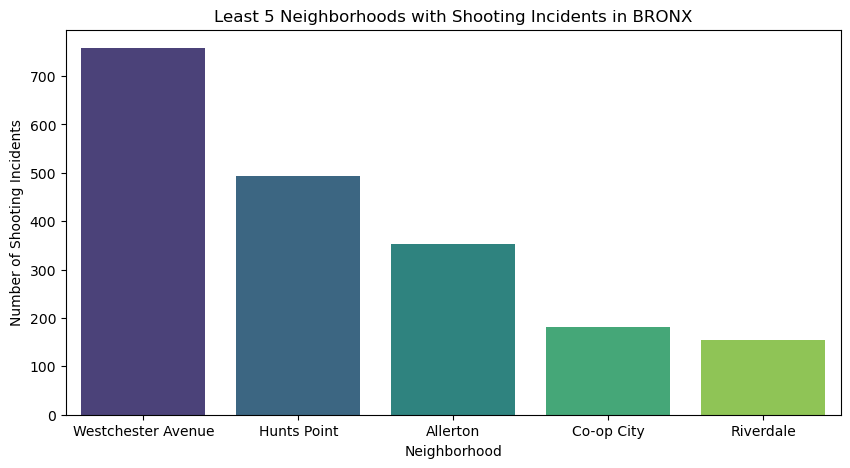

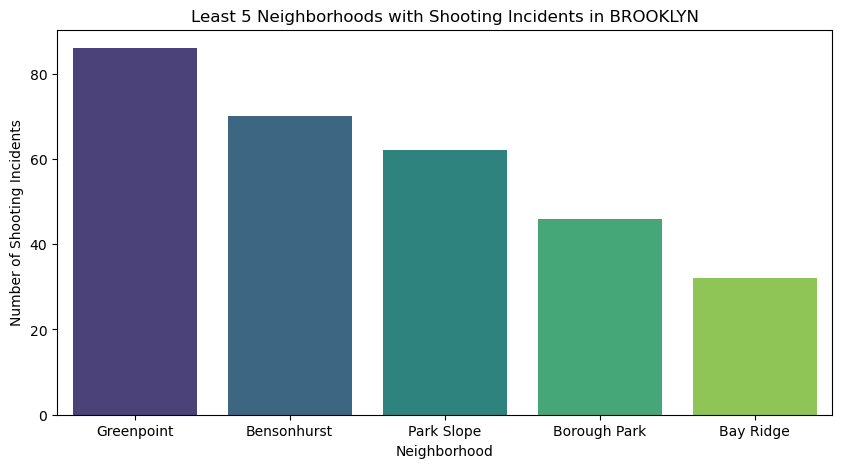

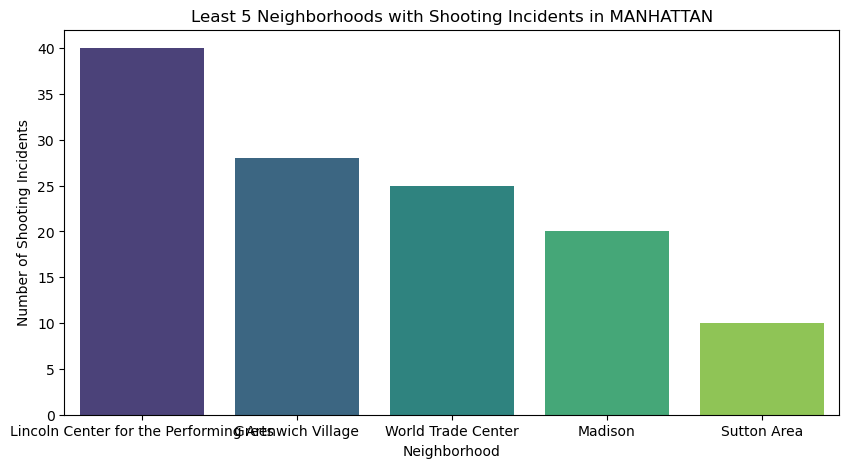

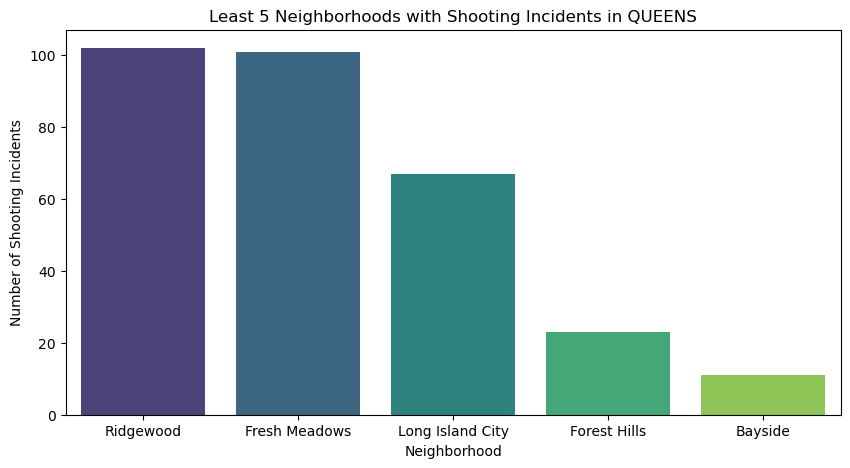

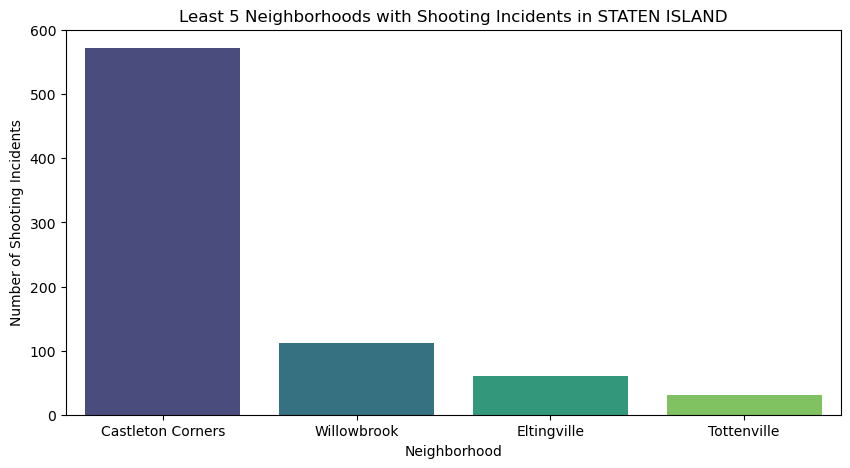

In [101]:
# Plot the least 5 precincts for each borough
for borough in neighborhood_counts_sorted['BORO'].unique():
    least5_neighborhoods = neighborhood_counts_sorted[neighborhood_counts_sorted['BORO'] == borough].tail(5)
    least5_neighborhoods['Short Neighborhood'] = least5_neighborhoods['NEIGHBORHOODS'].apply(lambda x: x.split('/')[0].strip())
    plt.figure(figsize=(10, 5))
    sns.barplot(x='Short Neighborhood', y='Incident Count', data=least5_neighborhoods, palette='viridis')
    plt.title(f'Least 5 Neighborhoods with Shooting Incidents in {borough}')
    plt.xlabel('Neighborhood')
    plt.ylabel('Number of Shooting Incidents')
    plt.show()